In [1]:
import torch
from transformers import CLIPProcessor, CLIPModel
import glob
from PIL import Image
from hdbscan import HDBSCAN
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.metrics import adjusted_rand_score, normalized_mutual_info_score
from sklearn.preprocessing import normalize
from sentence_transformers import SentenceTransformer, util

In [2]:
img_model = SentenceTransformer('clip-ViT-B-32')
text_model = SentenceTransformer('sentence-transformers/clip-ViT-B-32-multilingual-v1')

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


In [28]:
csv = "powerpoint_data.csv"
df = pd.read_csv(csv)

pairs = []
for _, row in df.iterrows():
    pairs.append((row['fixed title'],row['fixed image dir'], row['fixed body']))
    pairs.append((row['waiting title'], row["waiting image dir"], row["waiting body"]))
    pairs.append((row['not fixed title'], row["not fixed image dir"], row["not fixed body"]))

titles  = [p[0] for p in pairs]
image_paths = [p[1] for p in pairs]
all_texts   = [p[2] for p in pairs]


In [5]:
def load_image(path):
    return Image.open(path).convert("RGB")  # use path argument

images = [load_image(img_path) for img_path in image_paths]

img_embeddings = img_model.encode(images, convert_to_tensor=True)
print("Image embeddings shape:", img_embeddings.shape)

Image embeddings shape: torch.Size([270, 512])


In [6]:
text_embeddings = text_model.encode(all_texts, convert_to_tensor=True)
print("Text embeddings shape:", text_embeddings.shape)

Text embeddings shape: torch.Size([270, 512])


In [7]:
cos_sim = util.cos_sim(text_embeddings, img_embeddings)

for text, scores in zip(all_texts, cos_sim):
    max_img_idx = torch.argmax(scores)
    print("Text:", text)
    print("Score:", scores[max_img_idx] )
    print("Path:", image_paths[max_img_idx], "\n")

Text: Da min farfar døde, arvede jeg hans teaktræsmoduler til at bygge en sofa samt lænestol. Følgende havde været brugt i mange år, og flere dele var derfor ødelagte. For at sætte sofaen i stand, sleb jeg træet og gav det nyt olie. Herudover købte jeg koldskum til nye hynder, som min mor hjalp mig med at sy betræk til. Desuden blev der også sat nye gjorde i bunden, da flere af de gamle sad løst eller var knækket.​
Score: tensor(0.2786)
Path: images\group13_62_Julie_2.png 

Text: Jeg er i øjeblikket ved at sætte nogle gamle arkitekttegnet konferencestole i stand, så de kan bruges som spisebordsstole. Her behandles træet, skruerne bliver udskiftet og hynderne får nyt skum og betræk.
Score: tensor(0.3005)
Path: images\group16_77_Emma_Roesen_Madsen_3.jpg 

Text: Jeg fik foræret nogle gamle vinglas, men i fragten til Aalborg knækkede en af dem i stilken. Følgende har jeg valgt ikke at reparere, da jeg har flere af samme glas, mens man også stadig vil kunne se skaden, hvis det blev limet.
S

In [8]:
all_texts[0]

'Da min farfar døde, arvede jeg hans teaktræsmoduler til at bygge en sofa samt lænestol. Følgende havde været brugt i mange år, og flere dele var derfor ødelagte. For at sætte sofaen i stand, sleb jeg træet og gav det nyt olie. Herudover købte jeg koldskum til nye hynder, som min mor hjalp mig med at sy betræk til. Desuden blev der også sat nye gjorde i bunden, da flere af de gamle sad løst eller var knækket.\u200b'

In [9]:
image_paths[0]

'images\\group01_0_Josephine_1.jpg'

In [10]:
normalized_embeddings = normalize(img_embeddings, norm="l2")

In [11]:
clusterer = HDBSCAN(
    min_cluster_size=4,
    min_samples=3
    #metric='precomputed' did not change the clusters
)
cluster_labels = clusterer.fit_predict(normalized_embeddings)

C:\Users\Sandra\Desktop\Work\Design\.venv\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
C:\Users\Sandra\Desktop\Work\Design\.venv\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


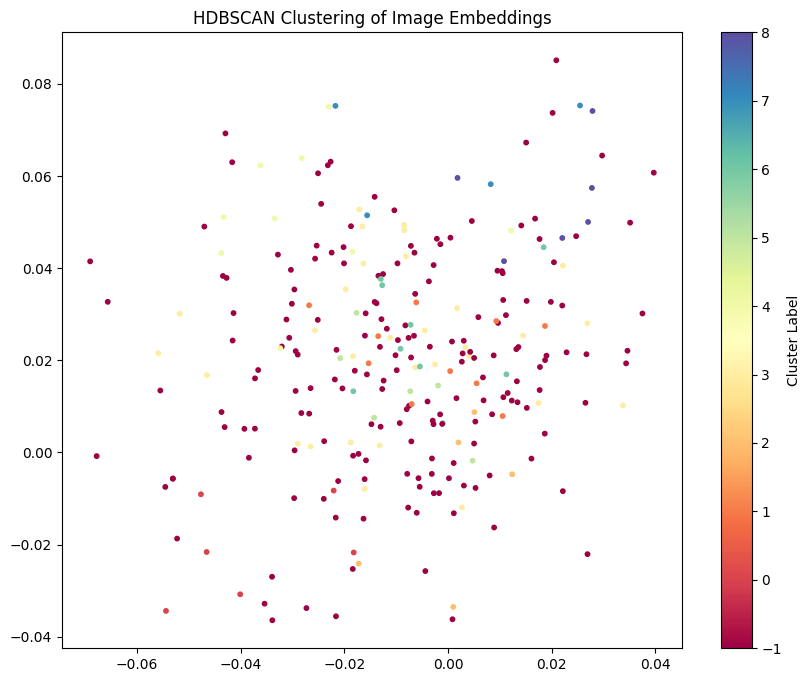

In [12]:
plt.figure(figsize=(10, 8))
plt.scatter(
    normalized_embeddings[:, 0],
    normalized_embeddings[:, 1],
    c=cluster_labels,
    cmap='Spectral',
    s=10
)
plt.colorbar(label='Cluster Label')
plt.title('HDBSCAN Clustering of Image Embeddings')
plt.show()


In [13]:
df = pd.DataFrame({
    "image": image_paths,
    "cluster": cluster_labels
})

print(df["cluster"].value_counts())

cluster
-1    184
 3     30
 1     10
 6      9
 4      9
 5      7
 0      6
 8      6
 2      5
 7      4
Name: count, dtype: int64


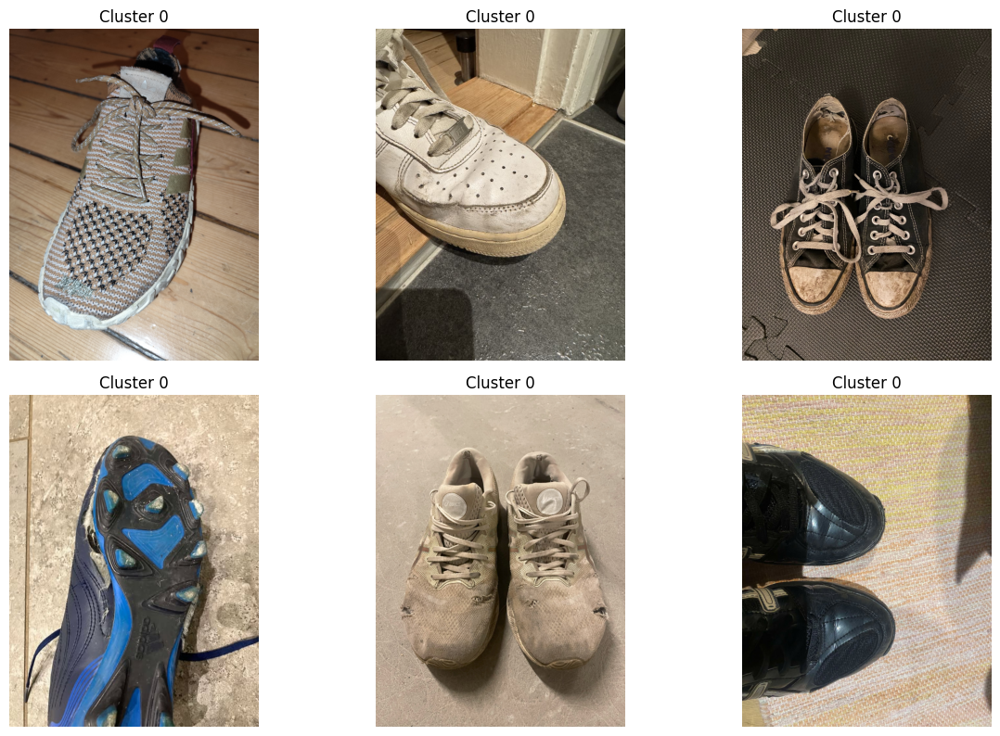

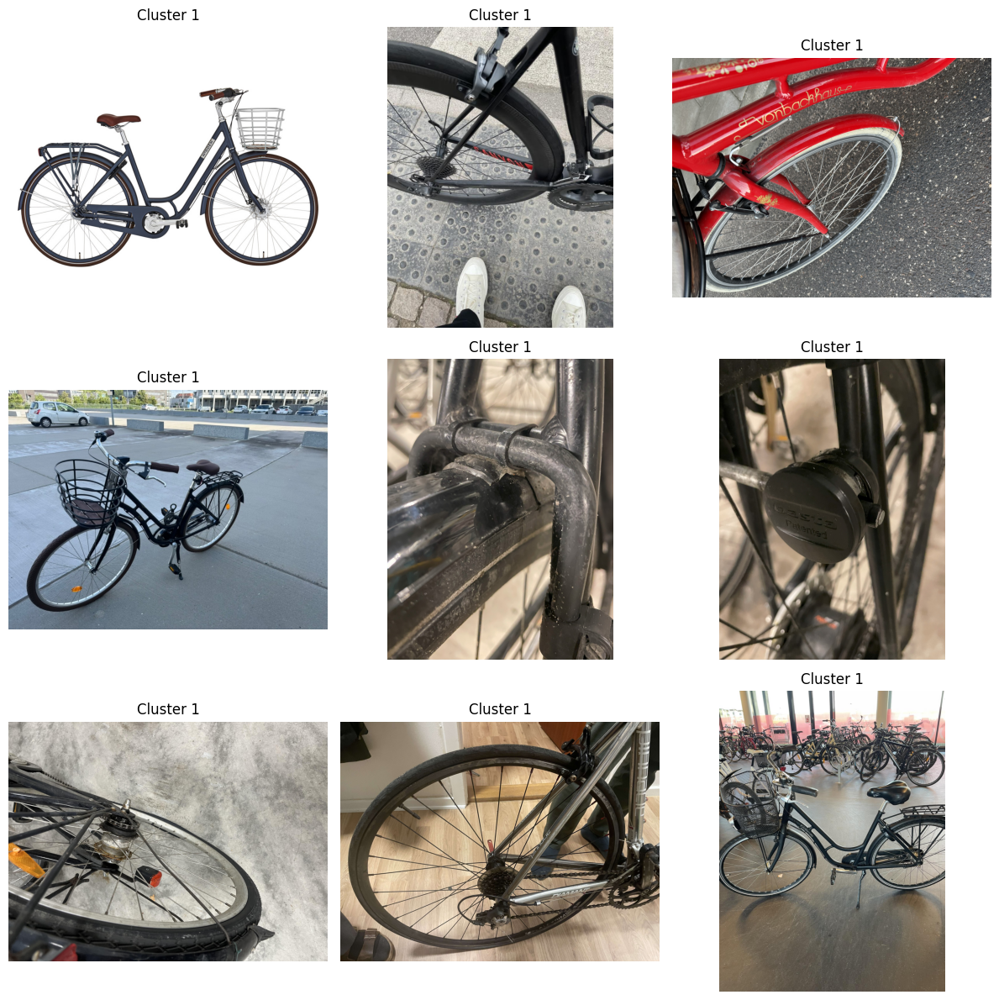

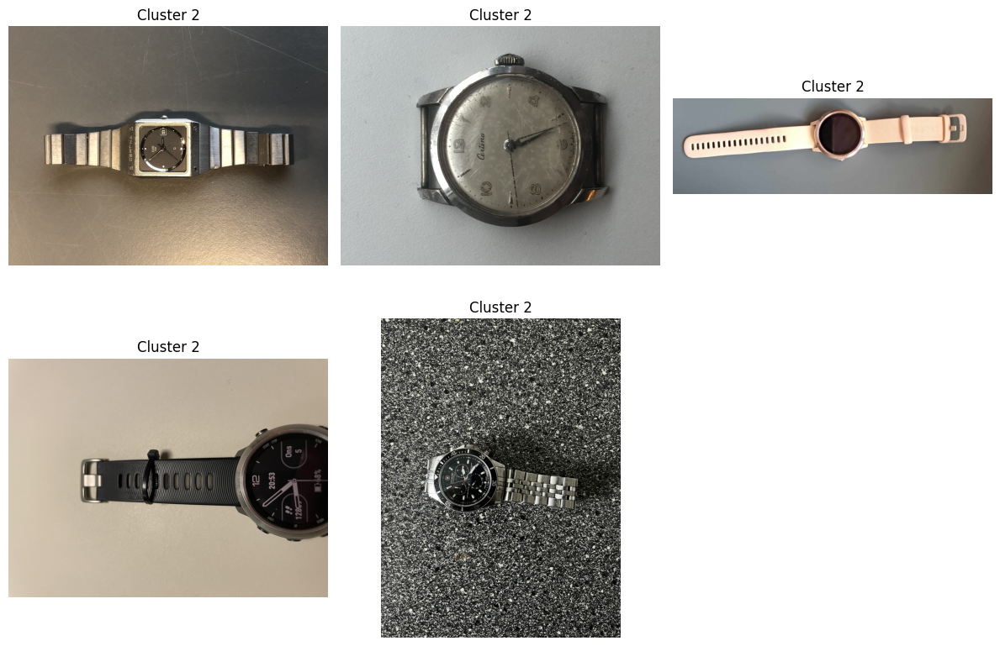

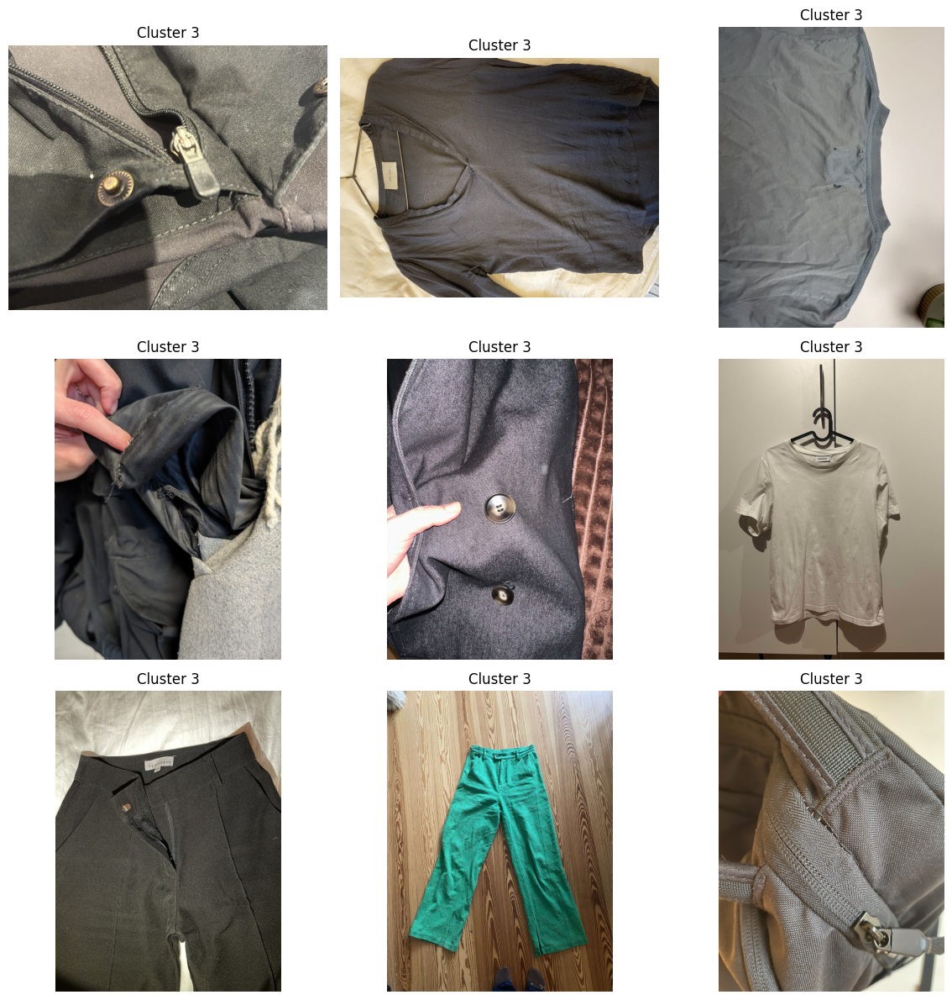

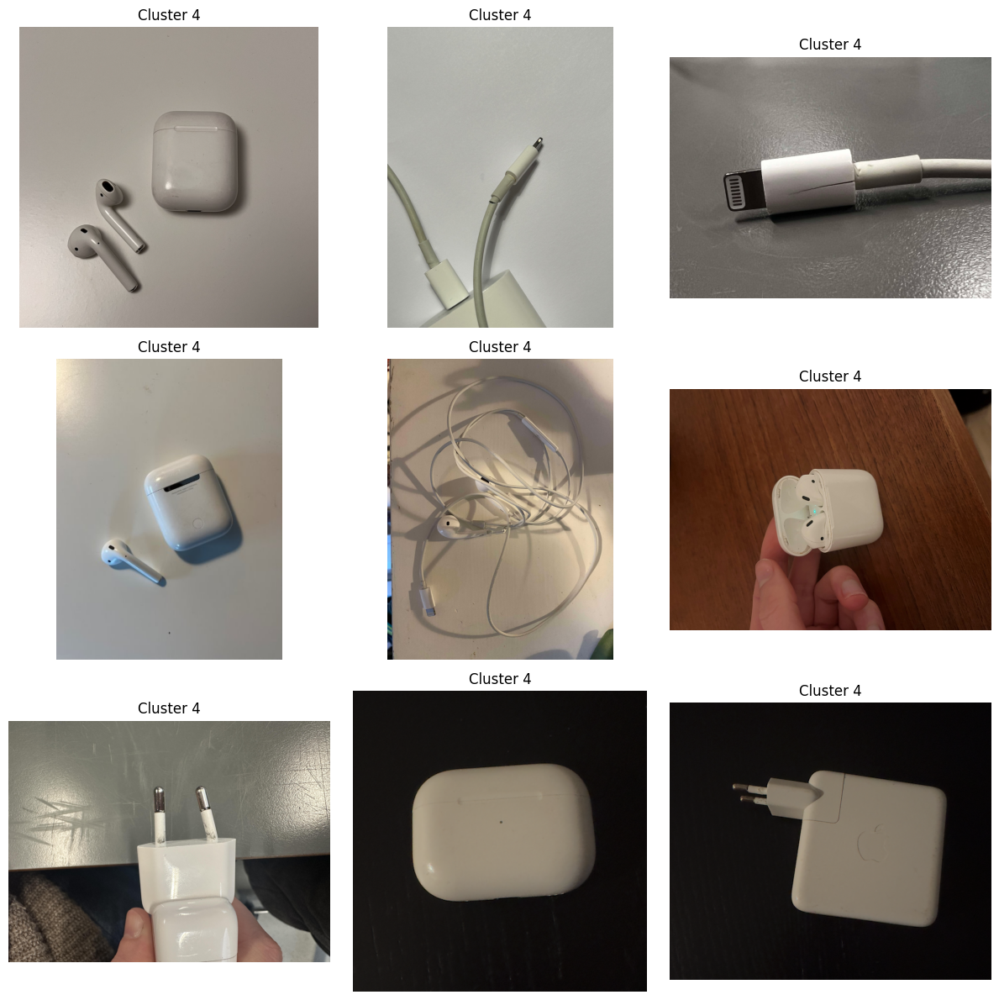

In [14]:
def show_cluster_images(cluster_number, n=9):
    paths = [path for path, label in zip(image_paths, cluster_labels) if label == cluster_number]
    sample_paths = paths[:n]

    plt.figure(figsize=(12, 12))
    for i, img_path in enumerate(sample_paths):
        plt.subplot(3, 3, i+1)
        img = Image.open(img_path)
        plt.imshow(img)
        plt.title(f"Cluster {cluster_number}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()

show_cluster_images(0)
show_cluster_images(1)
show_cluster_images(2)
show_cluster_images(3)
show_cluster_images(4)


In [17]:
num_clusters = df["cluster"].nunique() - (1 if -1 in df["cluster"].values else 0)
print(f"Number of clusters: {num_clusters}")

Number of clusters: 9


In [19]:
image_np = img_embeddings.cpu().numpy()
text_np = text_embeddings.cpu().numpy()

combined_embeddings = (image_np + text_np) / 2

In [20]:
normalized_embeddings2 = normalize(combined_embeddings, norm='l2')

In [21]:
cluster_labels2 = clusterer.fit_predict(normalized_embeddings2)

C:\Users\Sandra\Desktop\Work\Design\.venv\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
C:\Users\Sandra\Desktop\Work\Design\.venv\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


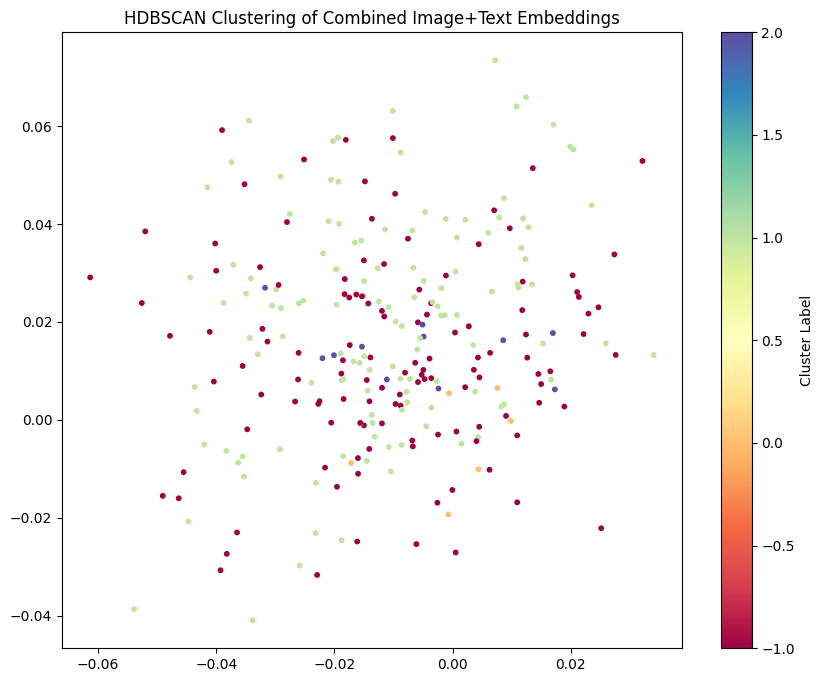

In [22]:
plt.figure(figsize=(10, 8))
plt.scatter(
    normalized_embeddings2[:, 0], normalized_embeddings2[:, 1],
    c=cluster_labels2,
    cmap='Spectral',
    s=10
)
plt.colorbar(label='Cluster Label')
plt.title('HDBSCAN Clustering of Combined Image+Text Embeddings')
plt.show()

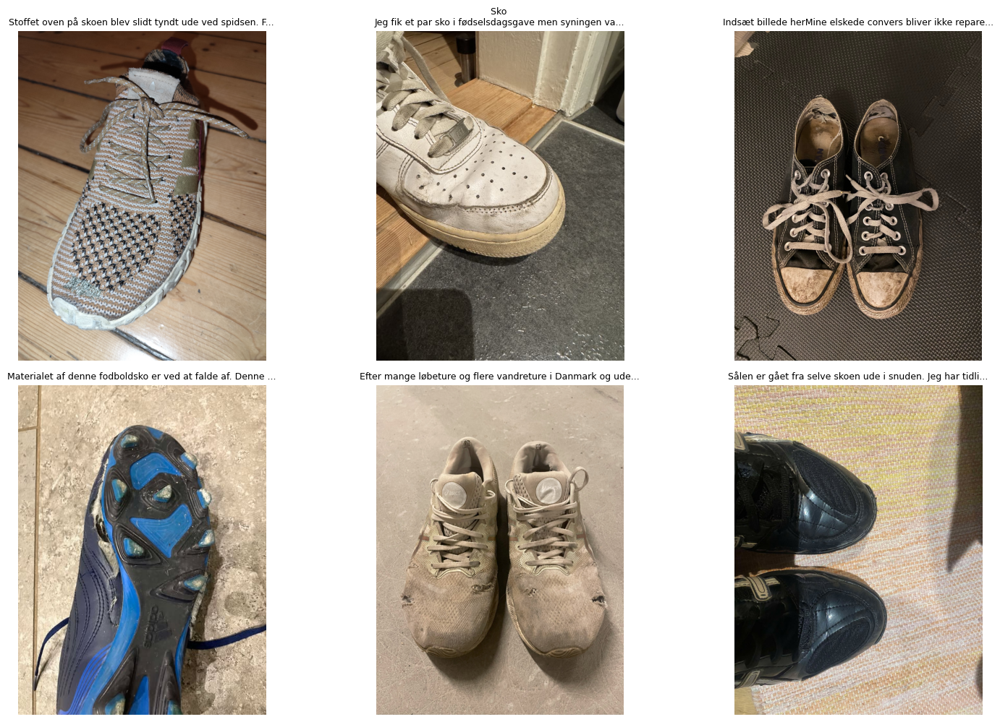

C:\Users\Sandra\AppData\Local\Temp\ipykernel_36456\2352129339.py:14: UserWarning: Glyph 9 (	) missing from current font.
  plt.tight_layout()
C:\Users\Sandra\Desktop\Work\Design\.venv\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 9 (	) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


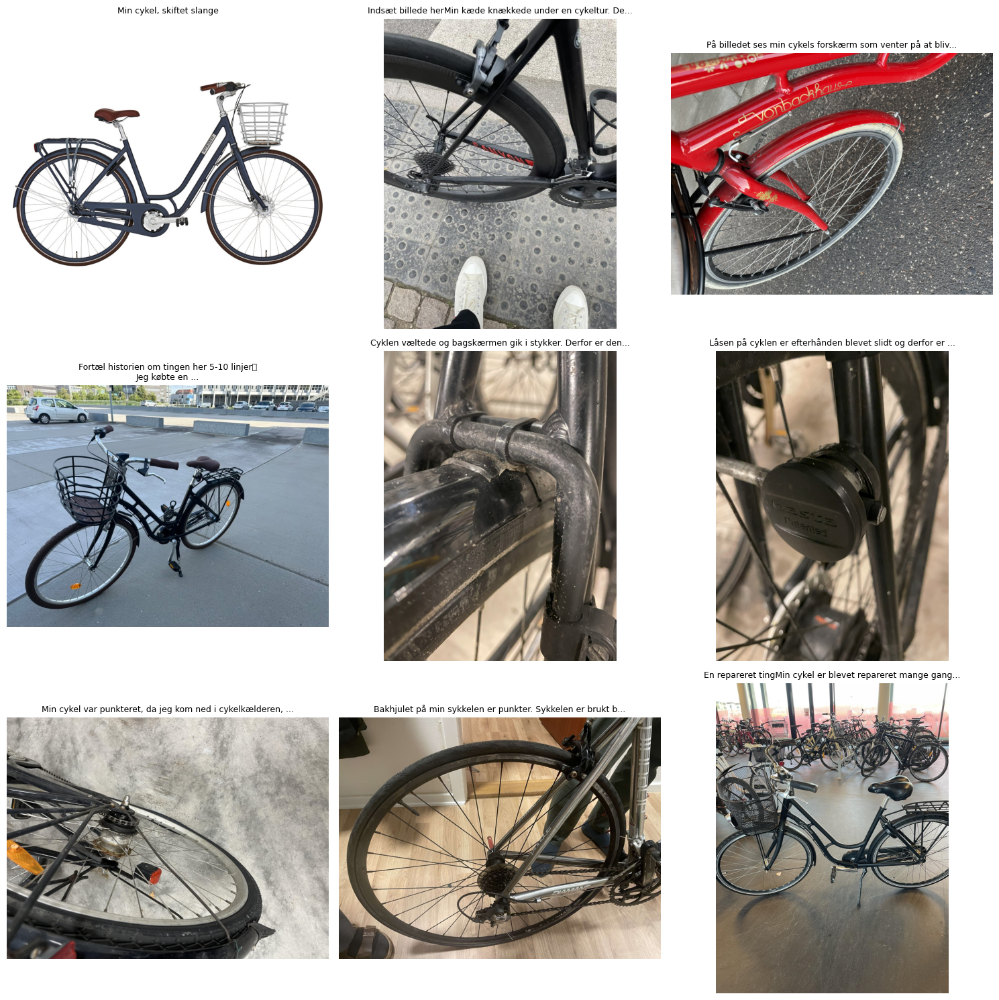

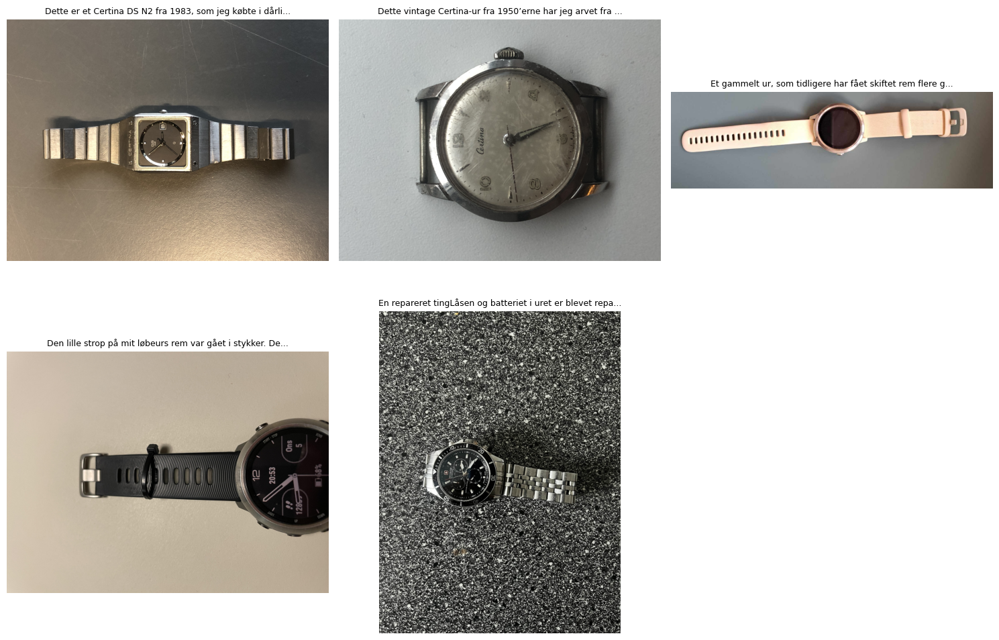

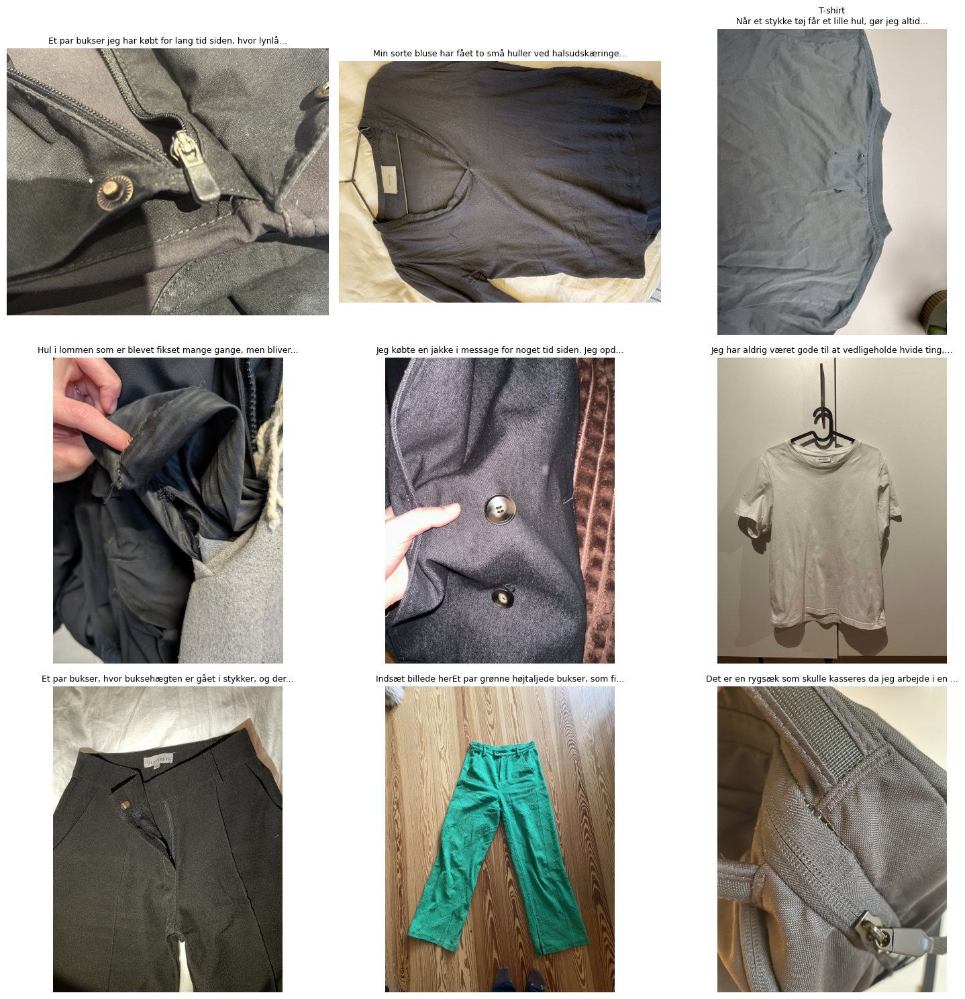

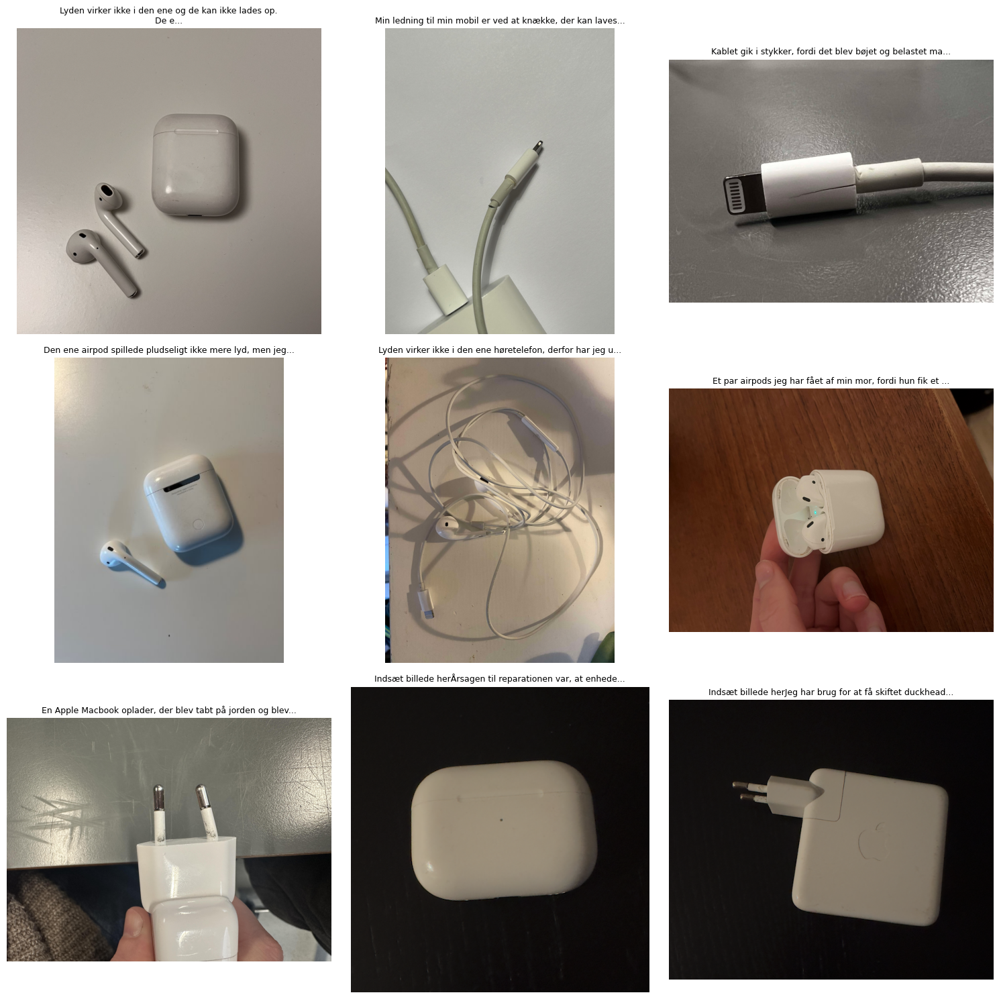

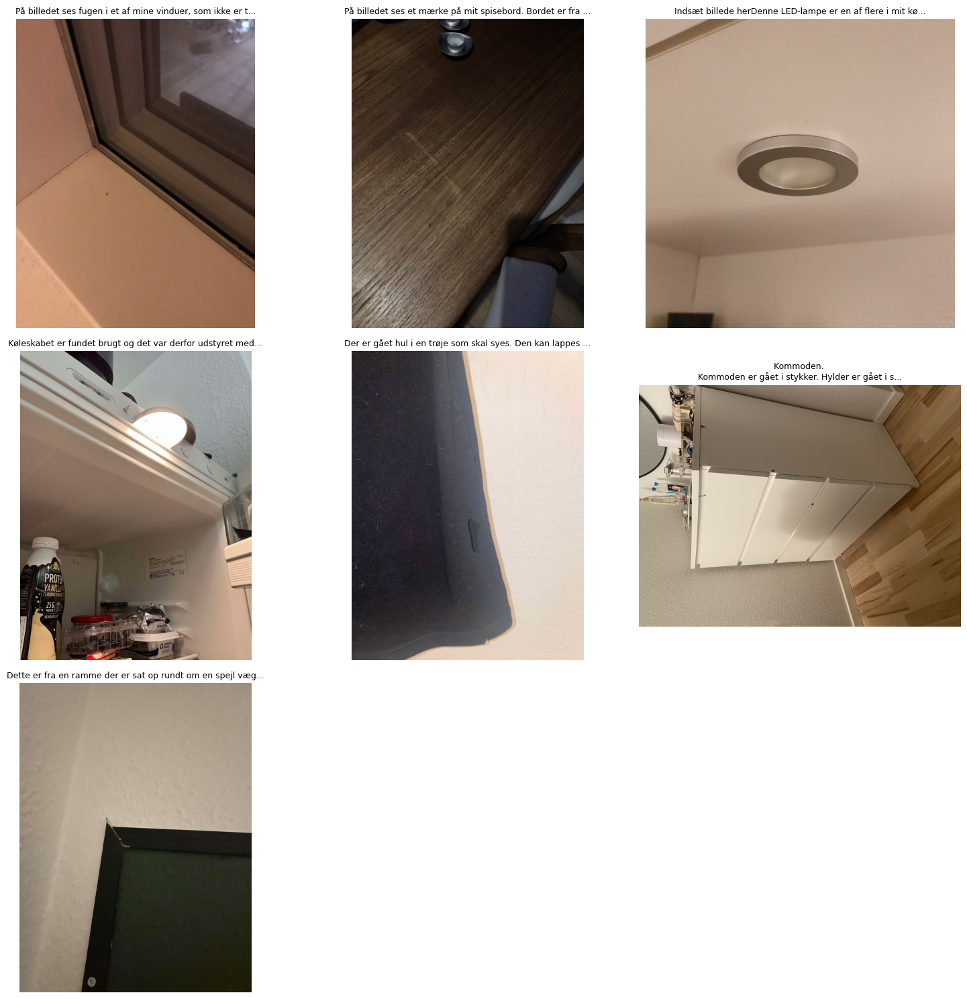

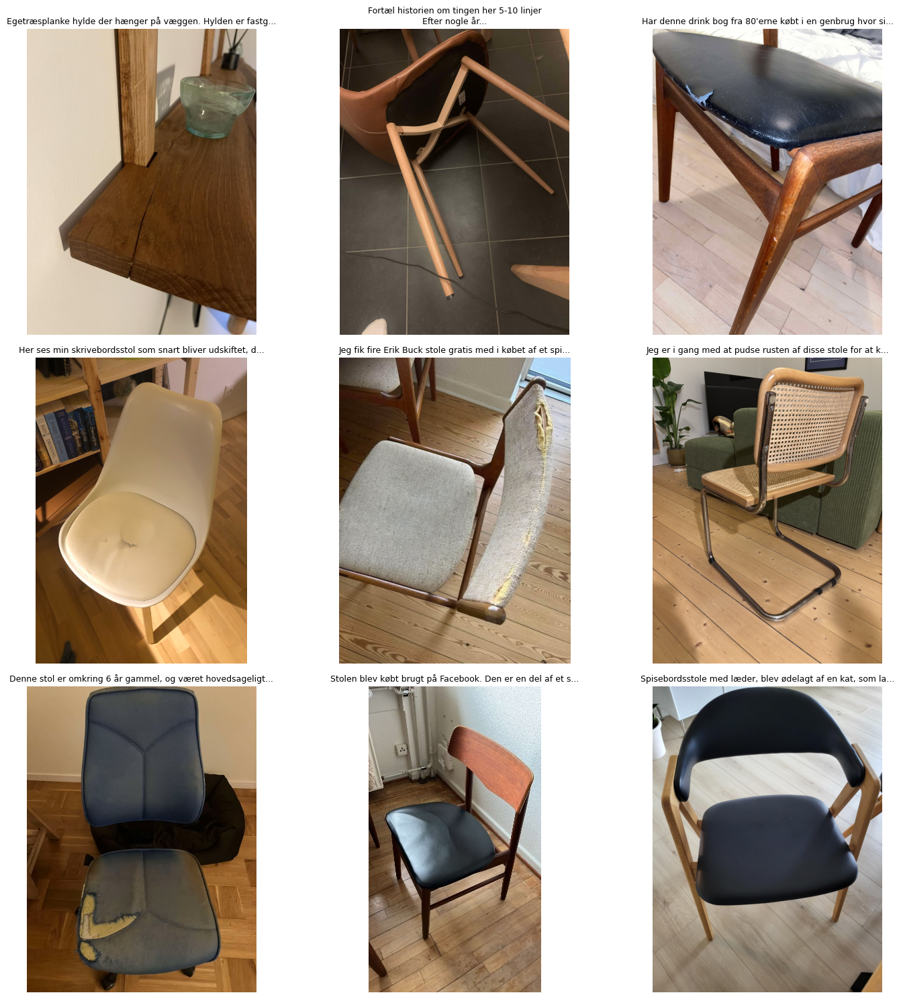

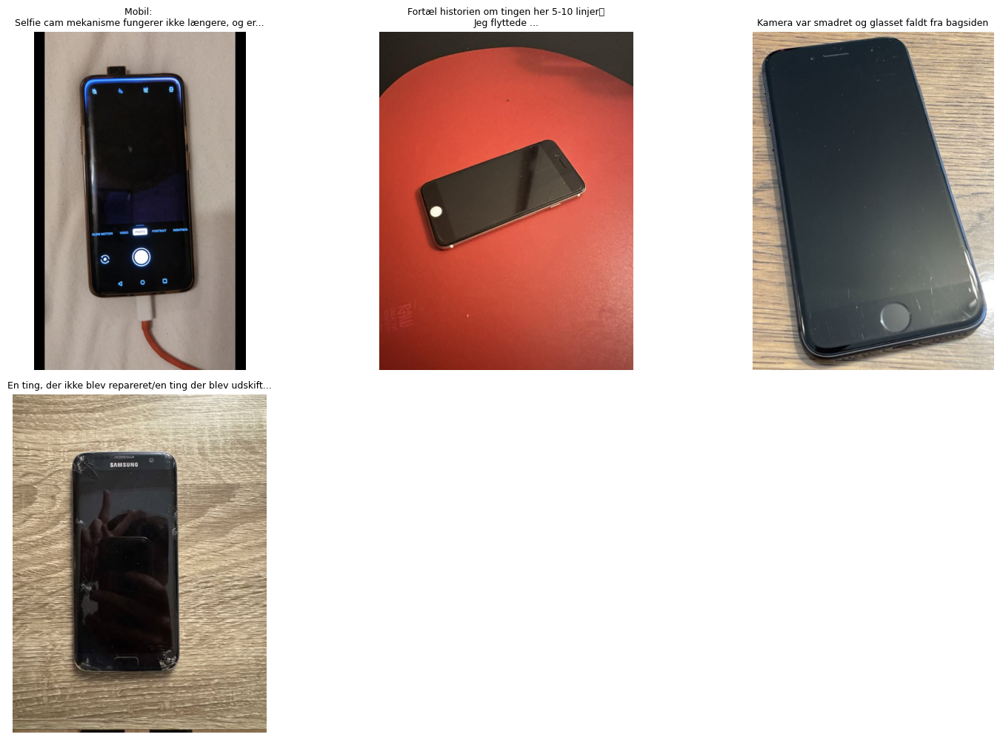

In [23]:
def show_cluster_images_with_text(cluster_number, n=9):
    filtered = [(path, txt) for path, txt, label in zip(image_paths, all_texts, cluster_labels) if label == cluster_number]
    sample = filtered[:n]

    plt.figure(figsize=(15, 15))
    for i, (img_path, txt) in enumerate(sample):
        plt.subplot(3, 3, i + 1)
        img = Image.open(img_path)
        plt.imshow(img)
        plt.axis('off')
        display_text = txt if len(txt) < 60 else txt[:57] + "..."
        plt.title(display_text, fontsize=9)

    plt.tight_layout()
    plt.show()

for cnum in range(8):
    show_cluster_images_with_text(cnum)

In [25]:
# ARI and NMI between image only and multi-modal clusters (embeddings from multilingual model)
ari = adjusted_rand_score(cluster_labels, cluster_labels2)
nmi = normalized_mutual_info_score(cluster_labels, cluster_labels2)
print(ari)
print(nmi)

0.2465146158660137
0.41055886638507433


In [26]:
categories = [
    "A photo of a refurbished product",
    "A photo of a product that is waiting to be repaired",
    "A photo of a product that was not repaired",
]

In [27]:
categories_embeddings = text_model.encode(categories, convert_to_tensor=True)

In [29]:
label_map = {
    "En repareret ting": "A photo of a refurbished product",
    "En ting, der venter på, eller er i gang med at blive repareret": "A photo of a product that is waiting to be repaired",
    "En ting, der ikke blev repareret/en ting der blev udskiftet": "A photo of a product that was not repaired",
}


In [30]:
true_labels = [label_map.get(t, None) for t in titles]

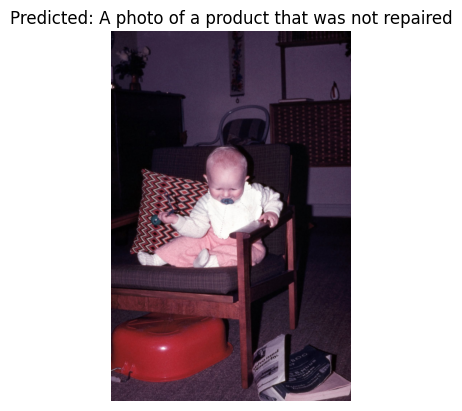

In [31]:
similarities = (100.0 * text_embeddings @ categories_embeddings.T).softmax(dim=-1)
predicted_idx = similarities.argmax(dim=1)
predicted_labels = [categories[i] for i in predicted_idx]


image = Image.open(image_paths[0]).convert("RGB")
plt.imshow(image)
plt.axis('off')
plt.title(f"Predicted: {predicted_labels[0]}")
plt.show()

In [32]:
from sklearn.metrics import accuracy_score
acc = accuracy_score(true_labels, predicted_labels)
print("Accuracy:", acc)

Accuracy: 0.3333333333333333
